<a href="https://colab.research.google.com/github/burntato/PCVK_Genap_2023/blob/master/UTS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import math
from google.colab.patches import cv2_imshow
import glob as glob
import os

**GENERATOR DO NOT RUN**

In [ ]:
image_path = '/content/drive/MyDrive/img/uts/vb.jpg' 
image = cv.imread(image_path)

save_folder = '/content/drive/MyDrive/img/uts/noise'  

for i in range(1, 101):
  noise = np.random.normal(0, i, image.shape)
  noisy_image = np.clip(image + noise, 0, 255).astype(np.uint8)
    
  save_path = os.path.join(save_folder, f'vbn{i}.jpg')
  cv.imwrite(save_path, noisy_image)
    

Safe code

In [ ]:
folder_path = '/content/drive/MyDrive/img/uts/noise'

cv_img = []

for img in glob.glob(folder_path + '/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

print(len(cv_img))

100


Gambar ke-10 = PSNR: 28.98 dB


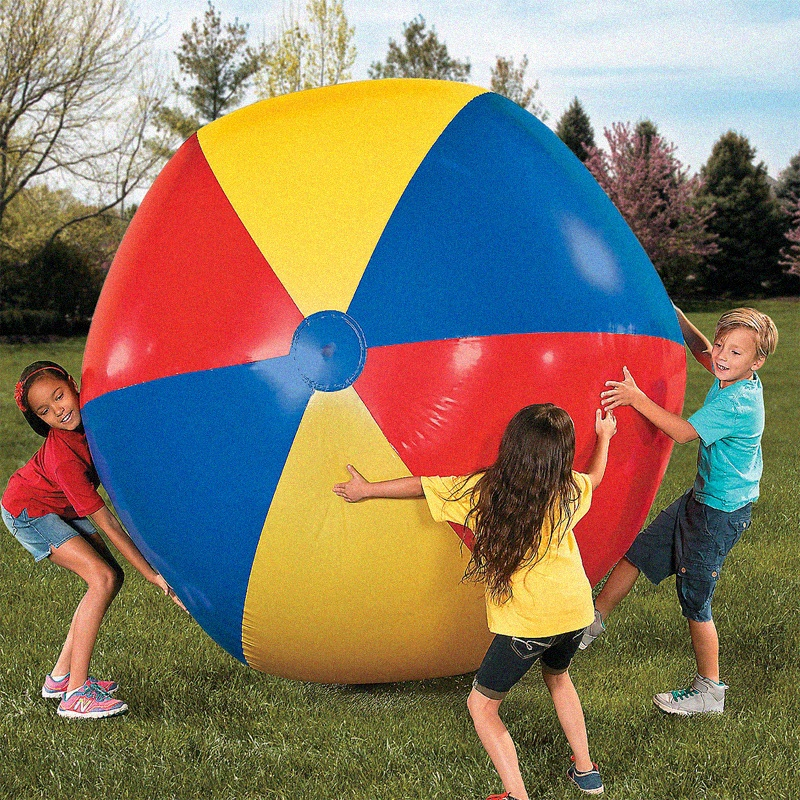

10
Gambar ke-20 = PSNR: 24.74 dB


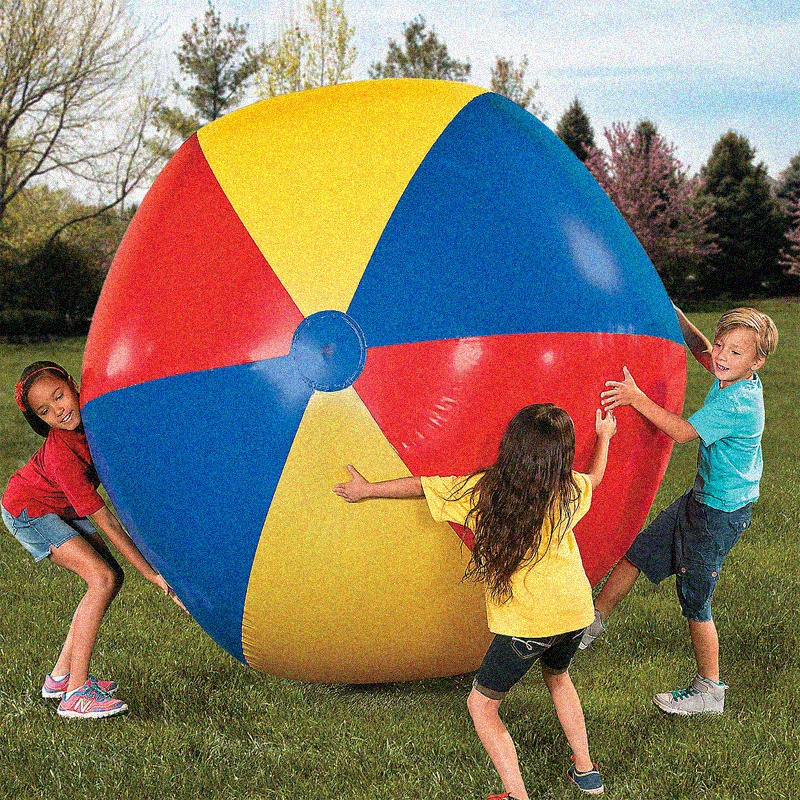

20
Gambar ke-30 = PSNR: 21.82 dB


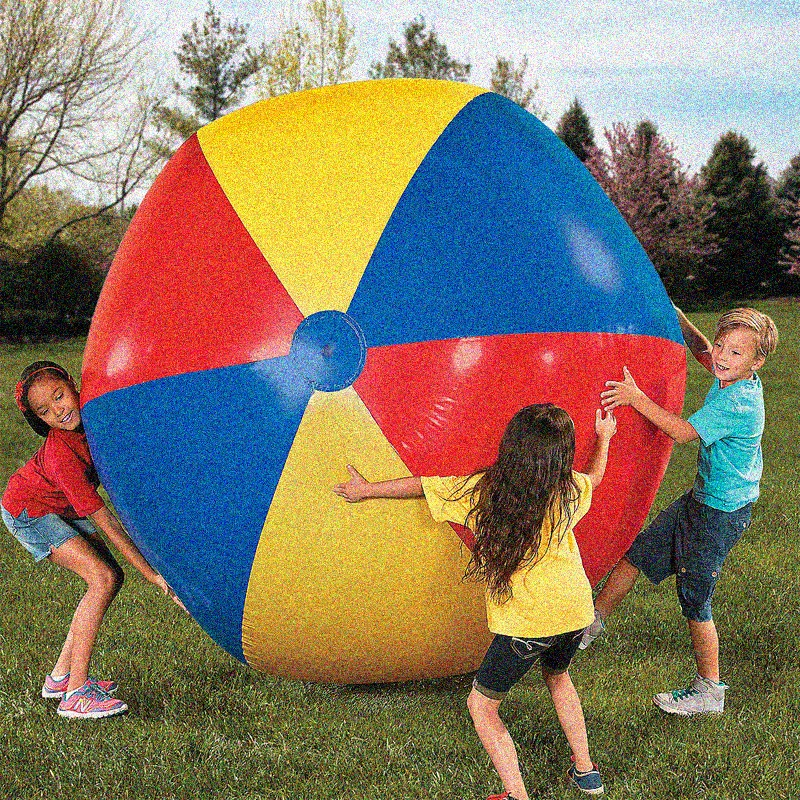

30
Gambar ke-40 = PSNR: 19.69 dB


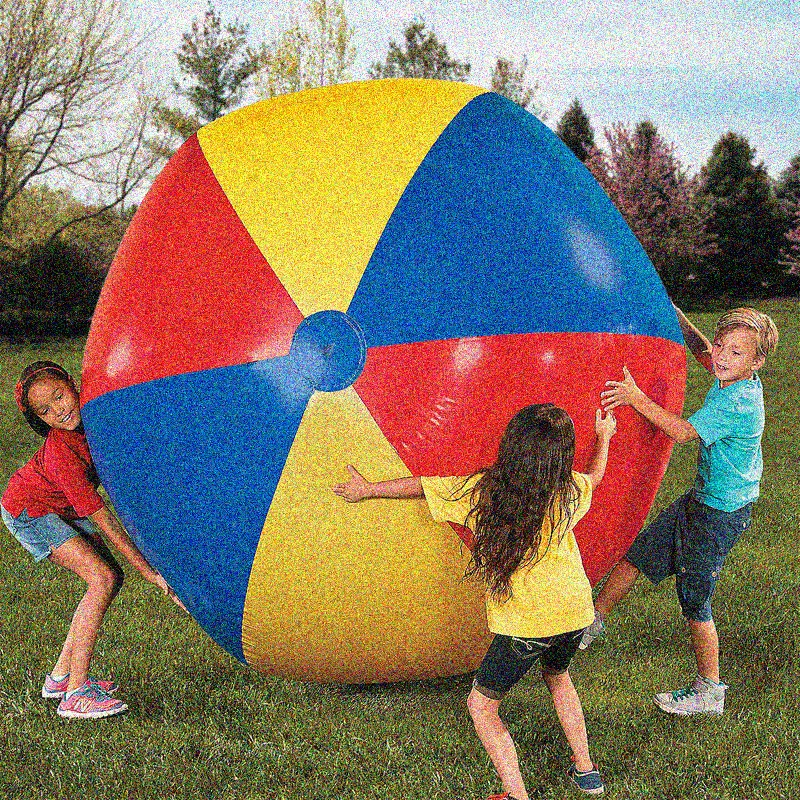

40
Gambar ke-50 = PSNR: 18.05 dB


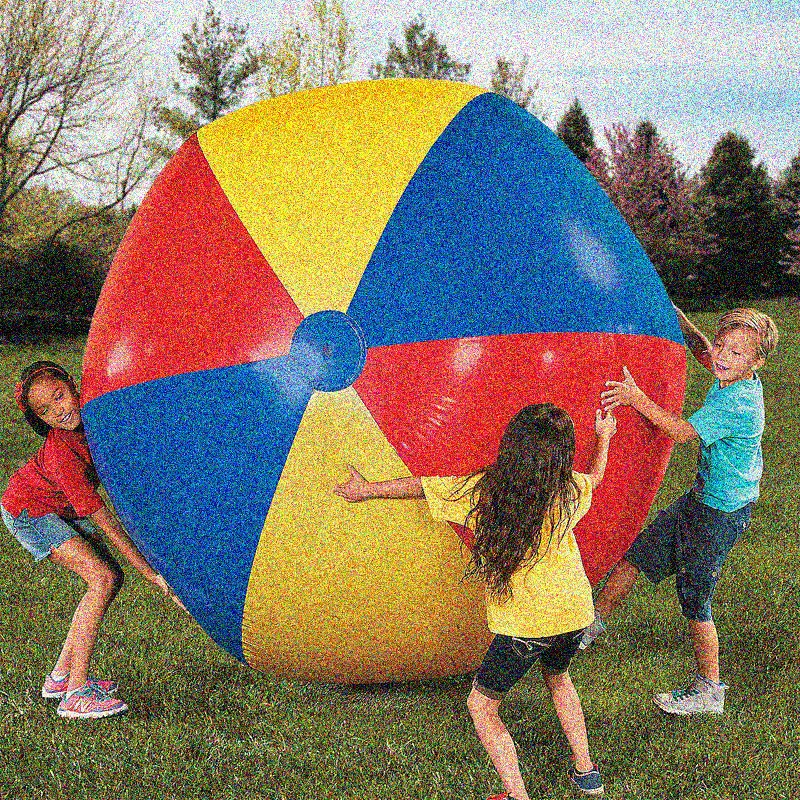

50
Gambar ke-60 = PSNR: 16.72 dB


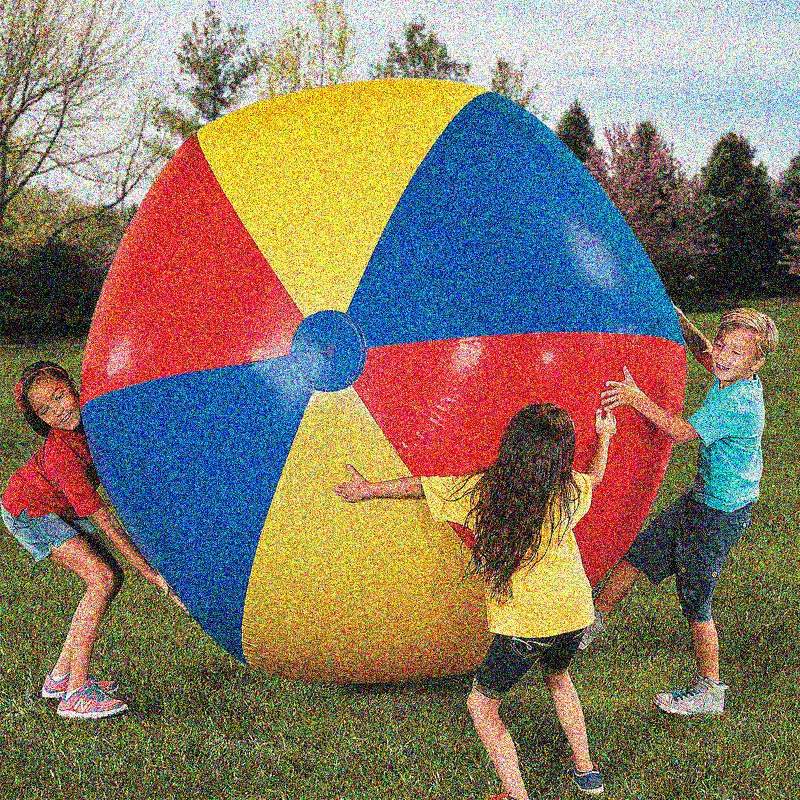

60
Gambar ke-70 = PSNR: 15.62 dB


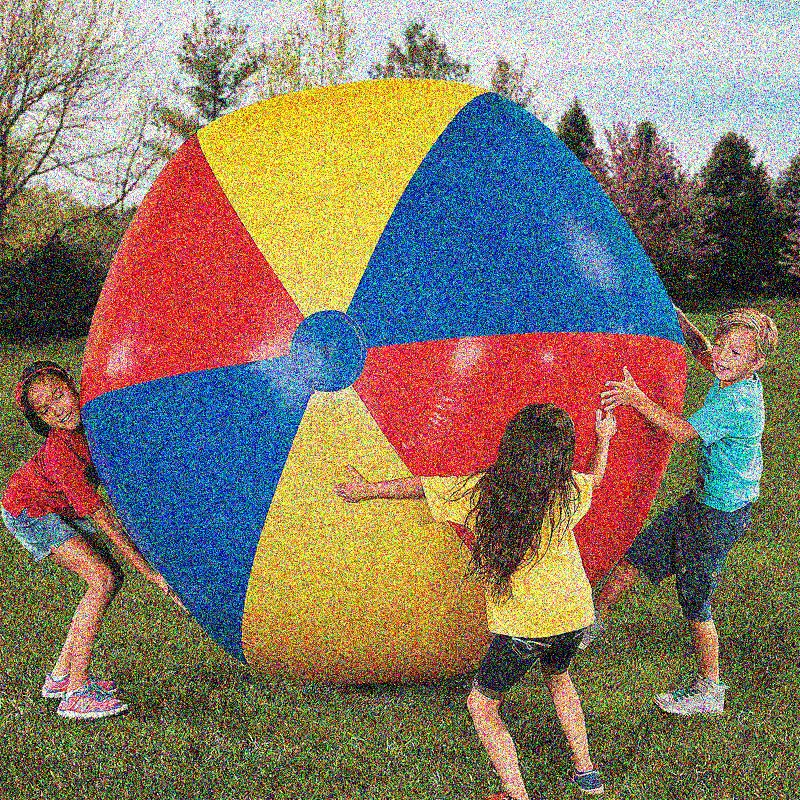

70
Gambar ke-80 = PSNR: 14.72 dB


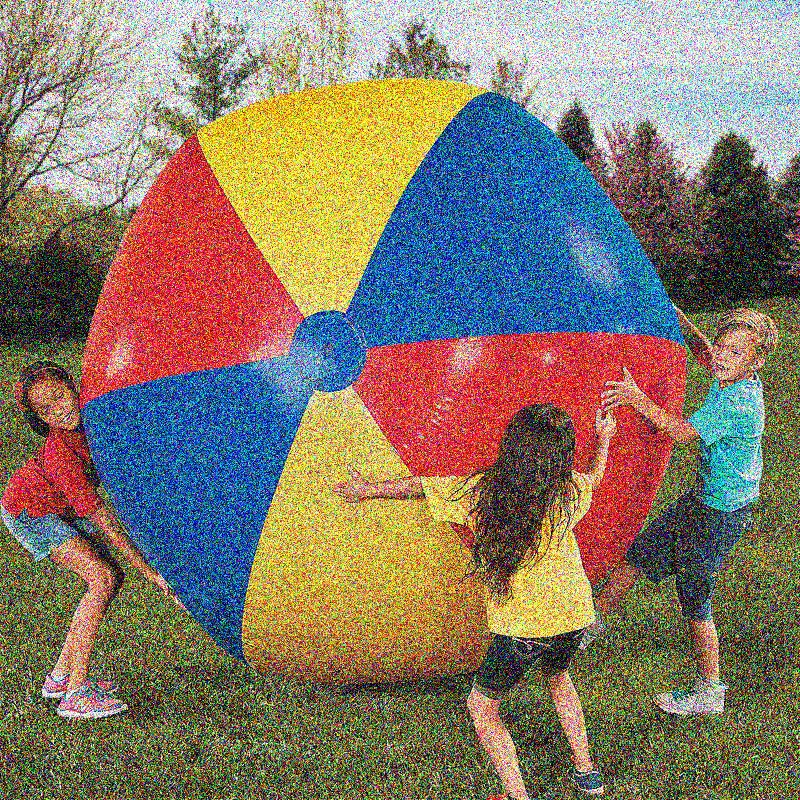

80
Gambar ke-90 = PSNR: 13.93 dB


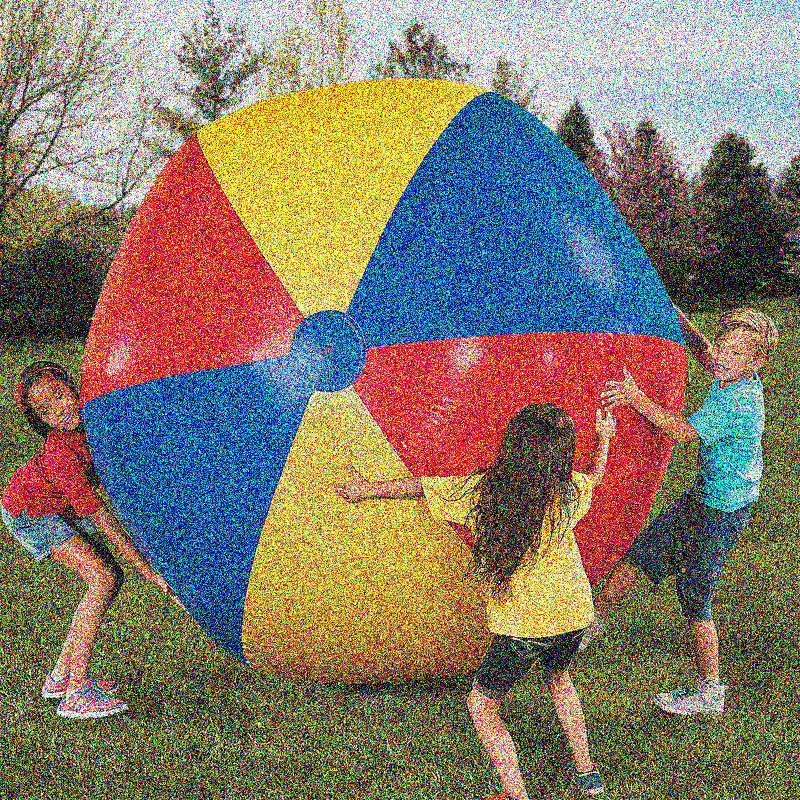

90
Gambar ke-100 = PSNR: 13.28 dB


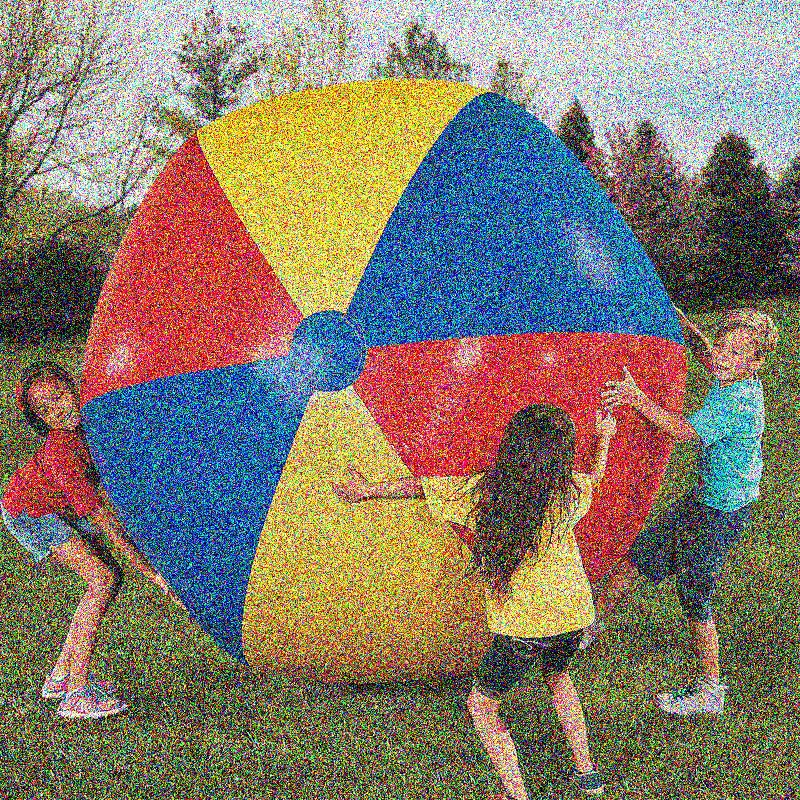

100


In [ ]:
target = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

for noise_level in target:
  index = noise_level - 1  
  if index < len(cv_img):
    image = cv_img[index]

    original_image = cv.imread('/content/drive/MyDrive/img/uts/vb.jpg')
    original_image = original_image.astype(np.uint8)
    psnr = cv.PSNR(original_image, image)

    print(f'Gambar ke-{noise_level} = PSNR: {psnr:.2f} dB')

    cv2_imshow(image)
    print(noise_level)

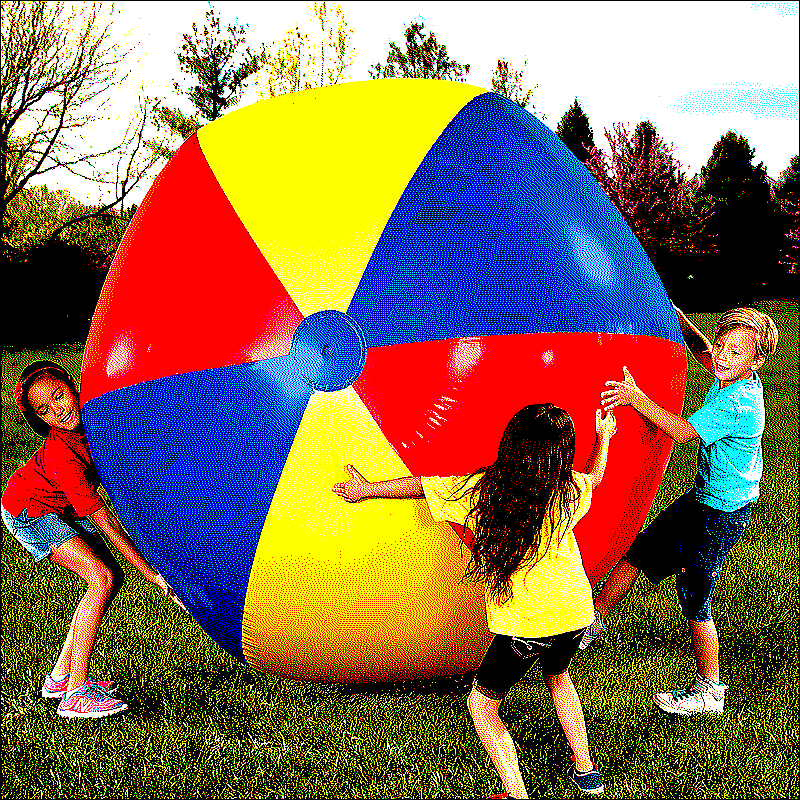

In [ ]:
image_path = '/content/drive/MyDrive/img/uts/vb.jpg'
original_image = cv.imread(image_path)

# JJN (Jarvis, Judice dan Ninke dithering)
dither = np.array([[0, 0, 0, 7, 5],
                   [3, 5, 7, 5, 3],
                   [1, 3, 5, 3, 1]]) / 48.0

out_img = np.zeros(original_image.shape, dtype=np.uint8)


for i in range(1, original_image.shape[0]-1):

  for j in range(1, original_image.shape[1]-1):

    old_pixel = original_image[i, j].astype(float)
    new_pixel = np.round(old_pixel / 255.0) * 255
    error = old_pixel - new_pixel
    out_img[i, j] = new_pixel.astype(np.uint8)

    for k in range(-1, 2):

      for l in range(-2, 3):

        if k == 0 and l == 0:
          continue

        if 0 <= i+k < original_image.shape[0] and 0 <= j+l < original_image.shape[1]:

          original_image[i+k, j+l] = np.clip(original_image[i+k, j+l] + error * dither[k+1, l+2], 0, 255).astype(np.uint8)

cv2_imshow(out_img)

In [ ]:
image_path = '/content/drive/MyDrive/img/uts/vb.jpg'
original_image = cv.imread(image_path)

# JJN (Jarvis, Judice dan Ninke dithering)
dither = np.array([[0, 0, 0, 7, 5],
                   [3, 5, 7, 5, 3],
                   [1, 3, 5, 3, 1]]) / 48.0

out_img = np.zeros(original_image.shape, dtype=np.uint8)


for i in range(1, original_image.shape[0]-1):

  for j in range(1, original_image.shape[1]-1):

    old_pixel = original_image[i, j].astype(float)
    new_pixel = np.round(old_pixel / 255.0) * 255
    error = old_pixel - new_pixel
    out_img[i, j] = new_pixel.astype(np.uint8)

    for k in range(-1, 2):

      for l in range(-2, 3):

        if k == 0 and l == 0:
          continue

        if 0 <= i+k < original_image.shape[0] and 0 <= j+l < original_image.shape[1]:

          original_image[i+k, j+l] = np.clip(original_image[i+k, j+l] + error * dither[k+1, l+2], 0, 255).astype(np.uint8)

cv2_imshow(out_img)

IndexError: ignored